**Lab 5: FIR Filtering 2**

The goal of this lab is to study the response of FIR filters to inputs such as complex exponentials and sinusoids. In the experiments of this lab, you will use `np.convolve()` to implement filters and `freqz()` to obtain the filter’s frequency response. As a result, you should learn how to characterize a filter by knowing how it reacts to different frequency components in the input.
This lab also introduces two practical filters: bandpass filters and nulling filters.
Bandpass filters can be used to detect and extract information from complex signals,
e.g., tones in a touch-tone telephone dialer. Nulling filters can be used to remove
sinusoidal interference, e.g., jamming signals in a radar.

In [33]:
import os
import numpy as np
import librosa
import IPython.display as ipd
from scipy import signal
import matplotlib.pyplot as plt

from util import load_audio, plot_signals, plot_spectrogram, plot_mean_spectrogram

1.1. First, let's replicate what we did until now. Copy the functions synthesize and envelope and obtain the synthesis from the last lab.

In [34]:
def averaging_filter(x, N):
    """
    Applies a N-point averaging filter to the input signal x

    Parameters
    ----------
    x : np.array
        The input signal in the form of a numpy array
    N : int
        The number of points used in N-point averaging filter

    Returns
    -------
    y : np.array
        The output of the filter
    """

    # Write your code here
    b = np.array([1.0/N]*N)
    y = np.convolve(x,b)

    return y

def envelope(x, N):
    """
    Extracts the envelope of the input signal x by concatenating a full-wave rectifier and an N-point averaging filter.

    Parameters
    ----------
    x : np.array
        The input signal in the form of a numpy array
    N : int
        The number of points used in N-point averaging filter

    Returns
    -------
    y : np.array
        The output of the system, i.e., the envelope of the signal x.
    """
    # write your code here
    w = np.abs(x)
    y = averaging_filter(w,N)

    return y

def synthesize(f0, phi, Ak, t):
  y = 0
  for k in range(1, len(Ak) + 1):
    y += Ak[k-1] * np.cos(2*np.pi*k*f0*t + k*phi - (k-1)*np.pi/2)
  return y

filepath = "./sis1_group102/audiolab1.wav"
ref, fs = load_audio(filepath)

N = 20
y = envelope(ref, N)


weights = [172.2656, 344.5313, 516.7969, 689.0625, 861.3281, 1033.594, 1205.859, 1378.125]
t = np.arange(0, len(y)/fs, 1.0/fs)
F0 = 415.3
synt = synthesize(F0, 5*np.pi/4, weights,t)

Synt_per_envelope = synt*y 

1.2 Plot both reference and synthesised signal.

In [5]:
# Write your code here
plot_signals([Synt_per_envelope, ref], fs, name=['synthesized per envelope', 'ref'])

In [35]:
plot_signals([ref], fs, name=['ref'])

---

**2. Averaging filter**

Now let's analyze the frequency response of the average filter used in the envelope function. The Scipy Python module has a function called *freqz()* for computing the frequency
response of a discrete-time LTI system. The following Python statements show how to
use freqz to compute and plot both the magnitude (absolute value) and the phase of
the frequency response of a four-point averaging system as a function of ω in the range − π ≤ ω ≤ π :

For FIR filters, the second argument of `freqz(-, 1,- )` must always be equal to 1. The frequency vector ww should cover an interval of length 2π for ω , and its spacing must be fine enough to give a smooth curve for H(ejω) . Note: we will always use capital H for the frequency response.

2.1 Use the `freqz` and `plot_frequency_response` functions to plot the frequency response of the averaging filter of your envelope function.



In [6]:
# Write your code here
from util import plot_frequency_response

# coefficients of averaging filter
b = [1/N] * N
ww = np.arange(-np.pi, np.pi, 0.01)

w, H = signal.freqz( b, 1, worN=ww)

plot_frequency_response(w, H)


2.2 Looking at the frequency responses, what are the main differences between your filter and the four-point averaging filter. What happens when the value N is increased?

[Double click to write your answer]

---

**3. Nulling Filters for Rejection**

Nulling filters are filters that completely eliminate some frequency components. If the frequency is $\omega=0$ or $\omega=\pi$ then a two-point FIR filter will do the nulling. The simplest possible general nulling filter can have as few as three coefficients. If $\omega_n$ is the desired nulling frequency, then the following length-3 FIR filter

$$
y[n] = x[n] - 2\cos(\omega_n)x[n-1] + x[n-2] 
$$

will have a zero in its frequency response at $\omega=\omega_n$. For example, a filter designed to completely eliminate signals of the form $e^{j0.5\pi}$ would have the following coefficients because we would pick the desired nulling frequency to be $\omega_n = 0.5\pi$

$$
b_0 = 1, \quad b1=-2cos(\omega_n)=0, \quad b_2=1
$$

3.1 Use the following function to add an interference in your reference signal. Name the corrupted signal as `x_interf`.

In [7]:
def add_interference(x, fs):
  # Write your code here
  f_int = 0.5*fs/2
  t = np.arange(0, len(x)/fs, 1.0/fs)

  int = 0.5 * np.sin(2 * np.pi * f_int * t)
  return x + int

In [8]:
# Write your code here
x_interf = add_interference(ref, fs)

3.2 Plot both the reference signal and the corrupted signal and listen to the latter one. 

In [9]:
# Write your code here
plot_signals([x_interf, ref], fs, name=["corrupted", "ref"])

3.3 Compare the spectrograms of the reference signal and the interference signal. 

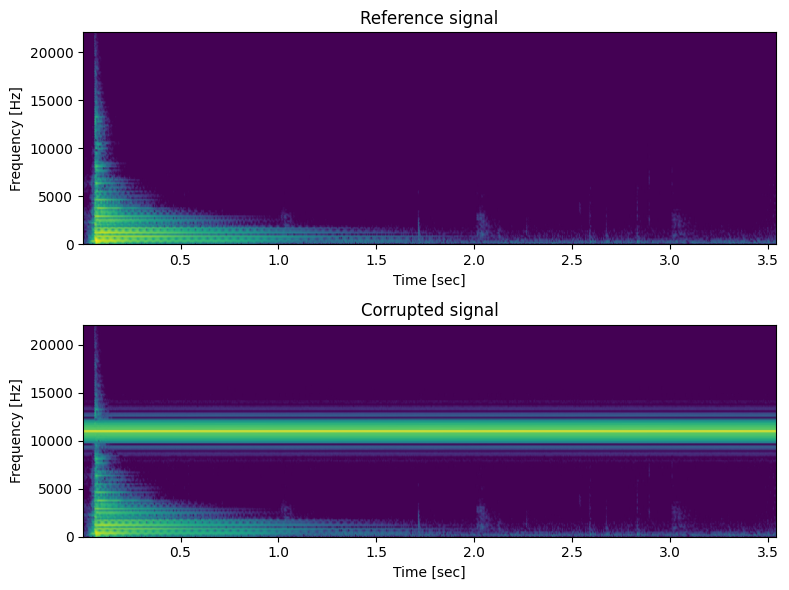

In [10]:
# Write your code here
ff, tt, S_ref= signal.spectrogram(ref, fs)
fff, ttf, S_interf= signal.spectrogram(x_interf, fs)


plt.figure(figsize=(8, 6))

plt.subplot(2, 1, 1)
plot_spectrogram(ff, tt, S_ref)
plt.title('Reference signal')

plt.subplot(2, 1, 2)
plot_spectrogram(ff, tt, S_interf)
plt.title('Corrupted signal')

plt.tight_layout()
plt.show()


3.4. Create a function `remove_interference(x, fs)` that applies a nulling filter devised to remove the interference at 1000 Hz. 

Note: remember that a frequency can be converted to the normalized radian frequncy by: $\omega_n = 2\pi f_n/f_s$

In [ ]:
def remove_interference(x, fs):
  """Applies nulling filter to remove an interference at 1000 Hz

  Parameters
  ----------
  x : np.array
      The input signal in the form of a numpy array
  fs : int or float
      Frequency rate in Hz

  Returns
  -------
  y : np.array
      The output of the filter

  """
  # Write your code here
  fn = 10000
  w_n = 2*np.pi*fn/fs

  b = [1, -2 * np.cos(w_n), 1]
  
  y = np.convolve(x, b)

  return y
  

3.5 Use the `remove_interference` funcion to clean the corrupted signal,  `x_interf`. Call the output as `x_clean`. Compare the spectrograms of both signals. Explain the result.

In [32]:
# Write your code here
x_clean = remove_interference(x_interf, fs)
plot_signals([x_interf, x_clean], fs, name=["corrupted", "clean"])
